# NLP I: Sentiment Analysis


Today, we're going to begin experimenting with natural language processing (NLP). We'll use various algorithms for feature extraction: bag of words, TF-IDF, and embeddings. We'll compare standard ML methods to DL and examine explainability.

## IMDB Dataset


Let's load the data:

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


As you can see, it contatings 50K records of reviews (strings) and their sentiments:

In [ ]:
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IMDB Dataset.csv')
df

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive
...,...,...
49995,I thought this movie did a down right good job...,positive
49996,"Bad plot, bad dialogue, bad acting, idiotic di...",negative
49997,I am a Catholic taught in parochial elementary...,negative
49998,I'm going to have to disagree with the previou...,negative


The classes are evenly distributed:

In [ ]:
df['sentiment'].value_counts()

positive    25000
negative    25000
Name: sentiment, dtype: int64

Let's look at one example:

In [ ]:
df.iloc[1, 0]

'A wonderful little production. <br /><br />The filming technique is very unassuming- very old-time-BBC fashion and gives a comforting, and sometimes discomforting, sense of realism to the entire piece. <br /><br />The actors are extremely well chosen- Michael Sheen not only "has got all the polari" but he has all the voices down pat too! You can truly see the seamless editing guided by the references to Williams\' diary entries, not only is it well worth the watching but it is a terrificly written and performed piece. A masterful production about one of the great master\'s of comedy and his life. <br /><br />The realism really comes home with the little things: the fantasy of the guard which, rather than use the traditional \'dream\' techniques remains solid then disappears. It plays on our knowledge and our senses, particularly with the scenes concerning Orton and Halliwell and the sets (particularly of their flat with Halliwell\'s murals decorating every surface) are terribly well d

We're going to follow this example throughout today's talk.

## Data preprocessing


Before training the ML algorithms, we need to clean the data and preprocess it.

### Cleaning the data

Let's begin by cleaning the text and removing any HTML leftovers:

In [ ]:
from bs4 import BeautifulSoup
import re

# Removing the html strips
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

# Removing the square brackets
def remove_between_square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)

# Removing the noisy text
def clean_text(text):
    text = strip_html(text)
    text = remove_between_square_brackets(text)
    return text

# Apply function on review column
df['review'] = df['review'].apply(clean_text)

In [ ]:
df.iloc[1, 0]

'A wonderful little production. The filming technique is very unassuming- very old-time-BBC fashion and gives a comforting, and sometimes discomforting, sense of realism to the entire piece. The actors are extremely well chosen- Michael Sheen not only "has got all the polari" but he has all the voices down pat too! You can truly see the seamless editing guided by the references to Williams\' diary entries, not only is it well worth the watching but it is a terrificly written and performed piece. A masterful production about one of the great master\'s of comedy and his life. The realism really comes home with the little things: the fantasy of the guard which, rather than use the traditional \'dream\' techniques remains solid then disappears. It plays on our knowledge and our senses, particularly with the scenes concerning Orton and Halliwell and the sets (particularly of their flat with Halliwell\'s murals decorating every surface) are terribly well done.'

Let's also remove special characters:

In [ ]:
# Define function for removing special characters
def remove_special_characters(text):
    pattern = r'[^a-zA-Z0-9\s]'
    text = re.sub(pattern,'',text)
    return text

# Apply function on review column
df['review'] = df['review'].apply(remove_special_characters)

In [ ]:
df.iloc[1, 0]

'A wonderful little production The filming technique is very unassuming very oldtimeBBC fashion and gives a comforting and sometimes discomforting sense of realism to the entire piece The actors are extremely well chosen Michael Sheen not only has got all the polari but he has all the voices down pat too You can truly see the seamless editing guided by the references to Williams diary entries not only is it well worth the watching but it is a terrificly written and performed piece A masterful production about one of the great masters of comedy and his life The realism really comes home with the little things the fantasy of the guard which rather than use the traditional dream techniques remains solid then disappears It plays on our knowledge and our senses particularly with the scenes concerning Orton and Halliwell and the sets particularly of their flat with Halliwells murals decorating every surface are terribly well done'

### Removing stop words

We'll be using a common Python package called Natural Language Toolkit (NLTK) to transform the textual data to a data science problem.

In [ ]:
import nltk

Let's download all English stop words that NLTK offers and look at a few of them:

In [ ]:
nltk.download('stopwords')
stopword_list = nltk.corpus.stopwords.words('english')
print('Number of English stop words:', len(stopword_list))
print(stopword_list[:5])

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
Number of English stop words: 179
['i', 'me', 'my', 'myself', 'we']


We'd like to remove these words from our text.
In order to do that we need to create a ToktokTokenizer instace:

In [ ]:
from nltk.tokenize.toktok import ToktokTokenizer
tokenizer = ToktokTokenizer()

Let's see what the tokenizer does:

In [ ]:
tokenizer.tokenize(df.iloc[1, 0])

['A',
 'wonderful',
 'little',
 'production',
 'The',
 'filming',
 'technique',
 'is',
 'very',
 'unassuming',
 'very',
 'oldtimeBBC',
 'fashion',
 'and',
 'gives',
 'a',
 'comforting',
 'and',
 'sometimes',
 'discomforting',
 'sense',
 'of',
 'realism',
 'to',
 'the',
 'entire',
 'piece',
 'The',
 'actors',
 'are',
 'extremely',
 'well',
 'chosen',
 'Michael',
 'Sheen',
 'not',
 'only',
 'has',
 'got',
 'all',
 'the',
 'polari',
 'but',
 'he',
 'has',
 'all',
 'the',
 'voices',
 'down',
 'pat',
 'too',
 'You',
 'can',
 'truly',
 'see',
 'the',
 'seamless',
 'editing',
 'guided',
 'by',
 'the',
 'references',
 'to',
 'Williams',
 'diary',
 'entries',
 'not',
 'only',
 'is',
 'it',
 'well',
 'worth',
 'the',
 'watching',
 'but',
 'it',
 'is',
 'a',
 'terrificly',
 'written',
 'and',
 'performed',
 'piece',
 'A',
 'masterful',
 'production',
 'about',
 'one',
 'of',
 'the',
 'great',
 'masters',
 'of',
 'comedy',
 'and',
 'his',
 'life',
 'The',
 'realism',
 'really',
 'comes',
 'home',


In [ ]:
# Removing the stopwords
from tqdm.notebook import tqdm
tqdm.pandas()

def remove_stopwords(text, is_lower_case=False):
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stopword_list]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stopword_list]
    filtered_text = ' '.join(filtered_tokens)    
    return filtered_text

# Apply function on review column
df['review'] = df['review'].progress_apply(remove_stopwords)

  0%|          | 0/50000 [00:00<?, ?it/s]

In [ ]:
df.iloc[1, 0]

'wonderful little production filming technique unassuming oldtimeBBC fashion gives comforting sometimes discomforting sense realism entire piece actors extremely well chosen Michael Sheen got polari voices pat truly see seamless editing guided references Williams diary entries well worth watching terrificly written performed piece masterful production one great masters comedy life realism really comes home little things fantasy guard rather use traditional dream techniques remains solid disappears plays knowledge senses particularly scenes concerning Orton Halliwell sets particularly flat Halliwells murals decorating every surface terribly well done'

### Stemming

We'll continue by stemming the text. It's basically quivalent to the linguistic definition of 'root', i.e. the root of 'running', 'runs', and 'ran' is 'run'. Since this operation happens per row it can take a while. We'll add a tqdm progress bar to improve visibility:

In [ ]:
# Stemming the text
def simple_stemmer(text):
    ps = nltk.porter.PorterStemmer()
    stemmed_words_list = []
    text = ' '.join([ps.stem(word) for word in text.split()])
    return text
# Apply function on review column
df['review'] = df['review'].progress_apply(simple_stemmer)

  0%|          | 0/50000 [00:00<?, ?it/s]

In [ ]:
df.iloc[1, 0]

'wonder littl product film techniqu unassum oldtimebbc fashion give comfort sometim discomfort sens realism entir piec actor extrem well chosen michael sheen got polari voic pat truli see seamless edit guid refer william diari entri well worth watch terrificli written perform piec master product one great master comedi life realism realli come home littl thing fantasi guard rather use tradit dream techniqu remain solid disappear play knowledg sens particularli scene concern orton halliwel set particularli flat halliwel mural decor everi surfac terribl well done'

### Train-test-valdiation split

In [ ]:
X = df['review']
Y = df['sentiment']

As usual, let's do a train-test-validation split:

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

We can also check that the distribution of our labels between test and train is not skewed toward one class:

In [ ]:
train_label_count = y_train.value_counts()
test_label_count = y_test.value_counts()

print('Train negative to positive ratio:', train_label_count['negative'] / train_label_count['positive']) 
print('Test negative to positive ratio:', test_label_count['negative'] / test_label_count['positive']) 

Train negative to positive ratio: 1.0039076198587245
Test negative to positive ratio: 0.9845207382417146


Let's split the test set to test and validation:

In [ ]:
x_val, x_test, y_val, y_test = train_test_split(x_test, y_test, test_size=0.5, random_state=42)

And verify our results:

In [ ]:
print('x_train shape:', x_train.shape)
print('y_train shape:', y_train.shape)
print('x_test shape:', x_test.shape)
print('y_test shape:', y_test.shape)
print('x_val shape:', x_val.shape)
print('y_val shape:', y_val.shape)

x_train shape: (40000,)
y_train shape: (40000,)
x_test shape: (5000,)
y_test shape: (5000,)
x_val shape: (5000,)
y_val shape: (5000,)


### Bag of words

Even after applying many transformations, the data is still in text/string format. We want to convert it to numerical values. One way to do it is via bag of words (BoW).

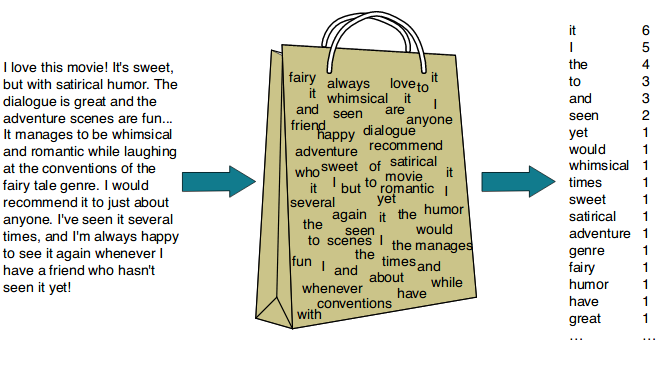

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(analyzer='word')

x_train_cv = cv.fit_transform(x_train)
x_test_cv = cv.transform(x_test)
x_val_cv = cv.transform(x_val)

print('x_train_cv:', x_train_cv.shape)
print('x_test_cv:', x_test_cv.shape)
print('x_val_cv:', x_val_cv.shape)

x_train_cv: (40000, 156043)
x_test_cv: (5000, 156043)
x_val_cv: (5000, 156043)


And now each sample is a sparse Numpy matrix:

In [ ]:
x_train_cv[0]

<1x156043 sparse matrix of type '<class 'numpy.int64'>'
	with 194 stored elements in Compressed Sparse Row format>

In [ ]:
print(x_train_cv[0])

  (0, 136180)	2
  (0, 75056)	1
  (0, 11522)	1
  (0, 83955)	3
  (0, 50275)	1
  (0, 119644)	1
  (0, 85149)	1
  (0, 133602)	1
  (0, 56194)	1
  (0, 85542)	1
  (0, 103837)	1
  (0, 3334)	1
  (0, 88462)	1
  (0, 29795)	1
  (0, 7819)	1
  (0, 129275)	2
  (0, 137482)	1
  (0, 98630)	1
  (0, 25437)	1
  (0, 80573)	1
  (0, 36516)	1
  (0, 147560)	1
  (0, 68688)	1
  (0, 23501)	1
  (0, 61630)	1
  :	:
  (0, 134147)	1
  (0, 66424)	1
  (0, 71440)	1
  (0, 5154)	1
  (0, 57348)	1
  (0, 145640)	1
  (0, 105807)	1
  (0, 62191)	1
  (0, 7769)	1
  (0, 35278)	1
  (0, 69309)	1
  (0, 151853)	1
  (0, 40959)	1
  (0, 95073)	1
  (0, 48269)	1
  (0, 109115)	1
  (0, 5081)	1
  (0, 87896)	1
  (0, 39147)	1
  (0, 109992)	1
  (0, 118329)	1
  (0, 17368)	1
  (0, 2470)	1
  (0, 141434)	1
  (0, 61877)	1


However, using bag of words could cause some problems. For example, order does not matter. These two sentences are considered the same:

In [ ]:
sentence1 = ['Hello world']
sentence2 = ['world hello']

In [ ]:
import numpy as np
np.array_equal(cv.transform(sentence1).toarray(), cv.transform(sentence2).toarray())

True

Perhaps the previous case was not harmful, but let's look at this one:

In [ ]:
sentence1 = ['Not bad, the show was very good']
sentence2 = ['Very bad, the show was not good']

In [ ]:
np.array_equal(cv.transform(sentence1).toarray(), cv.transform(sentence2).toarray())

True

In our case we're dealing with long paragraphs, so this could mitigate this effect.

### Term Frequency-Inverse Document Frequency model (TF-IDF)


This is another way to convert the data to a numerical format. Like BoW, this algorithm is based on a term's popularity. However, its score is negatively correlated with its popularity in all documents.

This time we're going to use only 5K different terms as a cut-off.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tv = TfidfVectorizer(analyzer='word', max_features=5000)

x_train_tv = tv.fit_transform(x_train)
x_test_tv = tv.transform(x_test)
x_val_tv = tv.transform(x_val)

print('x_train_tv:', x_train_tv.shape)
print('x_test_tv:', x_test_tv.shape)
print('x_val_tv:', x_val_tv.shape)

x_train_tv: (40000, 5000)
x_test_tv: (5000, 5000)
x_val_tv: (5000, 5000)


Once again we have a sparse matrix:

In [ ]:
x_train_tv[0]

<1x5000 sparse matrix of type '<class 'numpy.float64'>'
	with 161 stored elements in Compressed Sparse Row format>

Containing continuous values between [0, 1]:

In [ ]:
print(x_train_tv[0])

  (0, 2072)	0.10749492861865853
  (0, 4599)	0.044109877095715476
  (0, 73)	0.10468261010816424
  (0, 511)	0.1070078719097912
  (0, 3858)	0.06346341674833562
  (0, 2866)	0.09913047124860136
  (0, 135)	0.06691660529362677
  (0, 3481)	0.0798996075761135
  (0, 1651)	0.09231727079597034
  (0, 3059)	0.10681697965361805
  (0, 1390)	0.08178546082600995
  (0, 4912)	0.09012940931013136
  (0, 2317)	0.08744081173468378
  (0, 1182)	0.06266676027405436
  (0, 216)	0.06719369106944766
  (0, 2085)	0.08918401503460997
  (0, 3357)	0.04323303421525841
  (0, 4714)	0.05277415575696815
  (0, 1935)	0.04449936397490189
  (0, 136)	0.04753215793356084
  (0, 2410)	0.07777136858784599
  (0, 4402)	0.10959995040078963
  (0, 1531)	0.05270832568136651
  (0, 3785)	0.0918098358700321
  (0, 3073)	0.10779416992963994
  :	:
  (0, 4968)	0.0657719550683368
  (0, 405)	0.08010732134445303
  (0, 2065)	0.05283656912510035
  (0, 721)	0.06048908298276192
  (0, 2285)	0.08234123151633102
  (0, 4780)	0.09317120751248321
  (0, 1235)	0

### Labeling

We need to convert the values of 'positive' and 'negative' to ones and zeros:

In [ ]:
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
y_train = lb.fit_transform(y_train)
y_test = lb.transform(y_test)
y_val = lb.transform(y_val)

For example:

In [ ]:
y_train[:5]

array([[0],
       [0],
       [1],
       [0],
       [0]])

## Building a model

We'll compare logistic regression and random forest.

### Logistic regression clasifier

Let's also measure the time of each method:

In [ ]:
from sklearn.linear_model import LogisticRegression
import datetime

begin_time = datetime.datetime.now()
lr_bow = LogisticRegression(penalty='l2', max_iter=500, random_state=42)
lr_bow.fit(x_train_cv, y_train.ravel())
print('BOW time (seconds): ', str((datetime.datetime.now() - begin_time).seconds))

begin_time = datetime.datetime.now()
lr_tfidf = LogisticRegression(penalty='l2', max_iter=500, random_state=42)
lr_tfidf.fit(x_train_tv, y_train.ravel())
print('TFIDF time (seconds): ', str((datetime.datetime.now() - begin_time).seconds))

BOW time (seconds):  41
TFIDF time (seconds):  1


We see that the cut-off TF-IDF is much faster. Let's evaluate the two methods:

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve

def evaluate(model, model_name, x, y, scores_dict=None, roc_dict=None):
  y_pred = model.predict(x)
  y_pred_proba = model.predict_proba(x)[:, 1] 

  scores_dict[model_name] = {}
  scores_dict[model_name]['AUC'] = roc_auc_score(y, y_pred_proba)
  scores_dict[model_name]['Accuracy'] =  accuracy_score(y, y_pred)

  roc_dict[model_name] = {}
  roc_dict[model_name]['FPR'], roc_dict[model_name]['TPR'], _ = roc_curve(y, y_pred_proba)

  return scores_dict

In [ ]:
scores_dict = {}
roc_dict = {}

In [ ]:
evaluate(lr_bow, 'logistic_bow', x_test_cv, y_test, scores_dict, roc_dict)['logistic_bow']['Accuracy']

0.8896

In [ ]:
evaluate(lr_tfidf, 'logistic_tfidf', x_test_tv, y_test, scores_dict, roc_dict)['logistic_tfidf']['Accuracy']

0.8888

And we see that their accuracy is very similar, despite the fact that we used only 5K terms in the TF-IDF.

### Random forest

We'll build a Random Forest model as well:

In [ ]:
from sklearn.ensemble import RandomForestClassifier

begin_time = datetime.datetime.now()
rf_bow = RandomForestClassifier(random_state=42, n_jobs=-1, max_features=1/3, max_depth=5, n_estimators=100)
rf_bow.fit(x_train_cv, y_train.ravel())
print('BOW time (seconds): ', str((datetime.datetime.now() - begin_time).seconds))

begin_time = datetime.datetime.now()
rf_tfidf = RandomForestClassifier(random_state=42, n_jobs=-1, max_features=1/3, max_depth=5, n_estimators=100)
rf_tfidf.fit(x_train_tv, y_train.ravel())
print('TFIDF time (seconds): ', str((datetime.datetime.now() - begin_time).seconds))

BOW time (seconds):  33
TFIDF time (seconds):  37


In [ ]:
evaluate(rf_bow, 'rf_bow', x_test_cv, y_test, scores_dict, roc_dict)['rf_bow']['Accuracy']

0.727

In [ ]:
evaluate(rf_tfidf, 'rf_tfidf', x_test_tv, y_test, scores_dict, roc_dict)['rf_tfidf']['Accuracy']

0.729

And it performs worse than the standard logistic regression.

### Compare models

Let's compare oru results:

In [ ]:
scores_dict['logistic_bow'].keys()

dict_keys(['AUC', 'Accuracy'])

In [ ]:
for model in scores_dict.keys():
  print(model, scores_dict[model])

logistic_bow {'AUC': 0.9542663937076021, 'Accuracy': 0.8896}
logistic_tfidf {'AUC': 0.9591785686164933, 'Accuracy': 0.8888}
rf_bow {'AUC': 0.818964093464154, 'Accuracy': 0.727}
rf_tfidf {'AUC': 0.8176861982192366, 'Accuracy': 0.729}


In [ ]:
import pandas as pd
pd.DataFrame.from_dict(scores_dict)

,logistic_bow,logistic_tfidf,rf_bow,rf_tfidf
AUC,0.954266,0.959179,0.818964,0.817686
Accuracy,0.889600,0.888800,0.727000,0.729000


And we see the same results for the ROC AUC as well. Let's plot it:

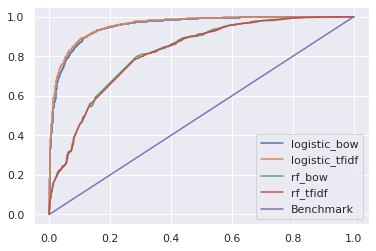

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()
for k, v in roc_dict.items():
  plt.plot(v['FPR'], v['TPR'], label=k)
plt.plot(v['FPR'], v['FPR'], label='Benchmark')
plt.legend()
plt.show()

## Deep learning

Let's build a DL model for this problem.

In [ ]:
from keras.models import Sequential
from keras.layers import Dropout, Conv1D, Flatten, Dense, Embedding
from keras.preprocessing import sequence
from tensorflow.keras.preprocessing.text import Tokenizer  

This time we're going to use Keras' tokenizer:

In [ ]:
token = Tokenizer(lower=False)
token.fit_on_texts(x_train)

Let's recall what x_train looks like:

In [ ]:
x_train.shape

(40000,)

And convert to sequences:

In [ ]:
x_train_dl = token.texts_to_sequences(x_train)
x_val_dl = token.texts_to_sequences(x_val)
x_test_dl = token.texts_to_sequences(x_test)

In [ ]:
x_train_dl[0]

[102,
 724,
 366,
 40,
 282,
 841,
 753,
 2270,
 265,
 4227,
 7431,
 10011,
 112,
 1512,
 25,
 417,
 27,
 3427,
 10,
 52,
 959,
 1643,
 1015,
 242,
 110,
 866,
 375,
 7938,
 71,
 1189,
 20072,
 1689,
 1843,
 151,
 20,
 57,
 383,
 184,
 18958,
 137,
 2191,
 75,
 15,
 3,
 996,
 24,
 61,
 2,
 137,
 234,
 4170,
 31562,
 1355,
 8059,
 51,
 125,
 27646,
 38121,
 1436,
 2736,
 355,
 291,
 280,
 32,
 37,
 30,
 319,
 2708,
 446,
 2488,
 329,
 8060,
 1328,
 10012,
 53144,
 53145,
 180,
 86,
 358,
 380,
 76,
 2662,
 620,
 307,
 19,
 164,
 49,
 545,
 144,
 102,
 191,
 322,
 5,
 1286,
 157,
 53146,
 984,
 97,
 8430,
 1111,
 658,
 294,
 4,
 2526,
 7357,
 3175,
 1449,
 24896,
 75,
 127,
 81,
 121,
 75,
 941,
 677,
 6689,
 74,
 3929,
 883,
 1,
 603,
 11377,
 186,
 38122,
 174,
 9,
 40,
 40,
 81,
 2826,
 6053,
 288,
 62,
 2007,
 13343,
 94,
 621,
 278,
 1503,
 20073,
 2013,
 31563,
 11116,
 211,
 580,
 293,
 1497,
 1117,
 5280,
 1720,
 71,
 296,
 934,
 581,
 312,
 1105,
 185,
 1984,
 335,
 21378,
 21,


Calculate document lengths:

In [ ]:
doc_len_list = [len(doc) for doc in x_train_dl]

Longest, shortest, and average document:

In [ ]:
max(doc_len_list), min(doc_len_list), np.mean(doc_len_list)

(1429, 4, 119.67355)

Let's examine the distribution:

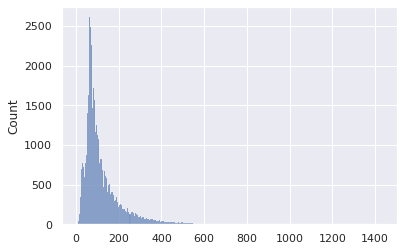

In [ ]:
sns.histplot(doc_len_list)

We want to make sure that all sequences have the same length. According to the distribution, 500 seems like a reasonable shared value:

In [ ]:
max_words = 500

x_train_dl = sequence.pad_sequences(x_train_dl, maxlen=max_words)
x_val_dl = sequence.pad_sequences(x_val_dl, maxlen=max_words)
x_test_dl = sequence.pad_sequences(x_test_dl, maxlen=max_words)

Let's see what a sample look like:

In [ ]:
x_train_dl.shape

(40000, 500)

In [ ]:
x_train_dl[10, :]

array([    0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,

In [ ]:
total_words = len(token.word_index) + 1 
total_words

156468

### Embeddings

As we saw, one-hot encoding based methods are very inefficient. Also, the concept of similarity between words doesn't exist. One way to solve this is to use word embeddings.

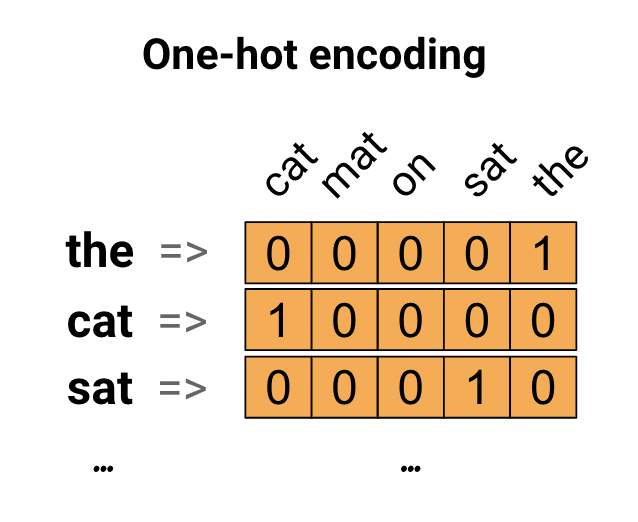

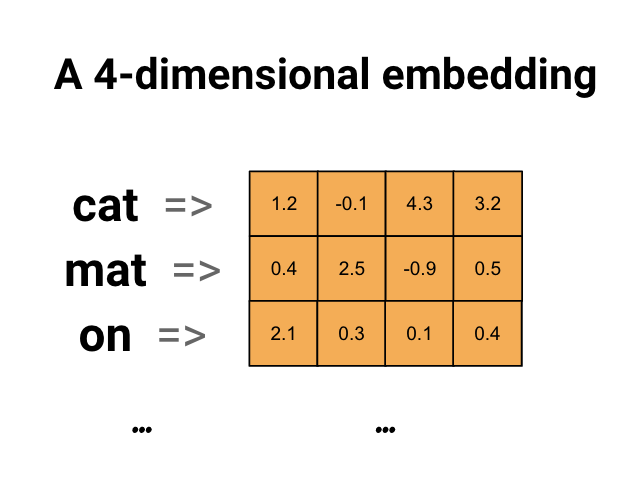

https://www.tensorflow.org/text/guide/word_embeddings

Embedding example using Word2Vec: http://vectors.nlpl.eu/explore/embeddings/en/#

Let's build the architecture:

In [ ]:
model = Sequential()
model.add(Embedding(input_dim=total_words, output_dim=32, input_length=max_words))
model.add(Conv1D(8, 3, padding='same', activation='relu'))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 500, 32)           5006976   
                                                                 
 conv1d (Conv1D)             (None, 500, 32)           3104      
                                                                 
 flatten (Flatten)           (None, 16000)             0         
                                                                 
 dense (Dense)               (None, 64)                1024064   
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                                 
Total params: 6,034,209
Trainable params: 6,034,209
Non-

Notice the first layer: an embedding layer. The purpose of embedding layers is to represent text data as meaningful vectors. Words that are similar to one another should have close values.

In [ ]:
model.fit(x_train_dl, y_train, validation_data=(x_val_dl, y_val), epochs=5, batch_size=64)

Epoch 1/5
625/625 [==============================] - 18s 13ms/step - loss: 0.3900 - accuracy: 0.8092 - val_loss: 0.2548 - val_accuracy: 0.8970
Epoch 2/5
625/625 [==============================] - 8s 12ms/step - loss: 0.1616 - accuracy: 0.9437 - val_loss: 0.2721 - val_accuracy: 0.8942
Epoch 3/5
625/625 [==============================] - 8s 12ms/step - loss: 0.0727 - accuracy: 0.9760 - val_loss: 0.3768 - val_accuracy: 0.8872
Epoch 4/5
625/625 [==============================] - 8s 12ms/step - loss: 0.0332 - accuracy: 0.9898 - val_loss: 0.5163 - val_accuracy: 0.8800
Epoch 5/5
625/625 [==============================] - 8s 12ms/step - loss: 0.0164 - accuracy: 0.9949 - val_loss: 0.6268 - val_accuracy: 0.8812


Let's evaluate our model:

In [ ]:
model.evaluate(x_test_dl, y_test)

157/157 [==============================] - 1s 4ms/step - loss: 0.5744 - accuracy: 0.8834


[0.5744085311889648, 0.883400022983551]

There are several ways to get the embedding (or any other) trained layer: 

In [ ]:
model.layers

In [ ]:
model.layers[0]

In [ ]:
model.get_layer('embedding')

In [ ]:
embedding_layer = model.get_layer('embedding')

In [ ]:
embedding_layer.weights[0]

<tf.Variable 'embedding/embeddings:0' shape=(156468, 32) dtype=float32, numpy=
array([[-5.4523791e-03,  1.5455087e-02,  2.2438161e-02, ...,
         1.1872598e-02, -1.9173235e-02, -4.8369315e-02],
       [-6.0250647e-02, -2.4968777e-02,  4.1381668e-02, ...,
         1.1774164e-02,  6.4907833e-03, -9.2074890e-03],
       [-4.7291156e-02,  2.7964063e-02,  4.4558146e-03, ...,
         3.9964933e-03,  6.9952086e-02,  1.6136892e-02],
       ...,
       [ 3.1863671e-02,  2.4718914e-02, -3.4383651e-02, ...,
         1.8899389e-02,  4.4311754e-02, -8.4429099e-05],
       [ 2.1808544e-02,  7.0883453e-02, -4.4397753e-02, ...,
        -5.0124355e-02, -1.7934319e-02,  8.6112224e-02],
       [-5.2589856e-02, -6.3263819e-02,  1.3042195e-01, ...,
         1.4052065e-01, -9.2648402e-02, -6.4299226e-02]], dtype=float32)>

Let's look at the embeddings of our previous example:

In [ ]:
sentence1 = ['not bad the show was very good']

In [ ]:
sentence2 = ['very bad the show was not good']

Here's their tokenization:

In [ ]:
[token.word_index.get(w) for w in sentence1[0].split()]

[12745, 24, 14578, 17, None, 87868, 6]

In [ ]:
[token.word_index.get(w) for w in sentence2[0].split()]

[87868, 24, 14578, 17, None, 12745, 6]

And we can see that order matters:

In [ ]:
tokenized1 = token.texts_to_sequences(sentence1)
tokenized2 = token.texts_to_sequences(sentence2)
print(tokenized1)
print(tokenized2)

[[12745, 24, 14578, 17, 87868, 6]]
[[87868, 24, 14578, 17, 12745, 6]]


In [ ]:
tokenized1 = sequence.pad_sequences(tokenized1, maxlen=max_words)
tokenized2 = sequence.pad_sequences(tokenized2, maxlen=max_words)

We can use the embedding on this single example:

In [ ]:
embedded1 = embedding_layer(tokenized1)
embedded2 = embedding_layer(tokenized2)
embedded1

<tf.Tensor: shape=(1, 500, 32), dtype=float32, numpy=
array([[[-0.00545238,  0.01545509,  0.02243816, ...,  0.0118726 ,
         -0.01917323, -0.04836931],
        [-0.00545238,  0.01545509,  0.02243816, ...,  0.0118726 ,
         -0.01917323, -0.04836931],
        [-0.00545238,  0.01545509,  0.02243816, ...,  0.0118726 ,
         -0.01917323, -0.04836931],
        ...,
        [ 0.00991562, -0.02416135,  0.04466879, ...,  0.02393005,
         -0.03175198,  0.02362278],
        [ 0.00110166, -0.03359812, -0.03019097, ..., -0.04112578,
         -0.0275403 ,  0.03353006],
        [ 0.00387905,  0.00032724, -0.03190844, ...,  0.02047952,
          0.00799248, -0.00735833]]], dtype=float32)>

And we see that the two representations are not the same:

In [ ]:
np.array_equal(embedded1.numpy(), embedded2.numpy())

False

### Visualization and explainability of embeddings

We can visualize the embedding:

In [ ]:
%load_ext tensorboard

In [ ]:
token.word_index

{'movi': 1,
 'film': 2,
 'one': 3,
 'like': 4,
 'time': 5,
 'good': 6,
 'make': 7,
 'see': 8,
 'get': 9,
 'charact': 10,
 'watch': 11,
 'even': 12,
 'stori': 13,
 'would': 14,
 'realli': 15,
 'scene': 16,
 'show': 17,
 'look': 18,
 'well': 19,
 'much': 20,
 'end': 21,
 'great': 22,
 'peopl': 23,
 'bad': 24,
 'also': 25,
 'love': 26,
 'think': 27,
 'go': 28,
 'first': 29,
 'act': 30,
 'play': 31,
 'dont': 32,
 'way': 33,
 'thing': 34,
 'made': 35,
 'could': 36,
 'know': 37,
 'say': 38,
 'seem': 39,
 'mani': 40,
 'seen': 41,
 'plot': 42,
 'want': 43,
 'work': 44,
 'take': 45,
 'actor': 46,
 'come': 47,
 'two': 48,
 'never': 49,
 'tri': 50,
 'best': 51,
 'littl': 52,
 'year': 53,
 'life': 54,
 'ever': 55,
 'give': 56,
 'better': 57,
 'man': 58,
 'find': 59,
 'still': 60,
 'perform': 61,
 'feel': 62,
 'use': 63,
 'part': 64,
 'actual': 65,
 'someth': 66,
 'lot': 67,
 'back': 68,
 'interest': 69,
 'real': 70,
 'director': 71,
 'guy': 72,
 'doesnt': 73,
 'didnt': 74,
 'Im': 75,
 'cast': 76,


Taken directly from TF's [guide](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin):

In [ ]:
from tensorboard.plugins import projector
import tensorflow as tf
import os

# Set up a logs directory, so Tensorboard knows where to look for files.
log_dir=os.path.join(os.getcwd(), '/logs/imdb-example/')
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# Save Labels separately on a line-by-line manner.

with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  words = token.word_index
  for subwords in words:
    f.write("{}\n".format(subwords))
  # Fill in the rest of the labels with "unknown".
  # for unknown in range(1, encoder.vocab_size - len(encoder.subwords)):
  #   f.write("unknown #{}\n".format(unknown))


# Save the weights we want to analyze as a variable. Note that the first
# value represents any unknown word, which is not in the metadata, here
# we will remove this value.
weights = tf.Variable(model.layers[0].get_weights()[0][1:])
# Create a checkpoint from embedding, the filename and key are the
# name of the tensor.
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# Set up config.
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
# The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`.
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

We can see the projection of our embedding using PCA. Points that are near one another should have similar meanings/contexts:

In [ ]:
# Now run tensorboard against on log data we just saved.
%tensorboard --logdir /logs/imdb-example/

Reusing TensorBoard on port 6006 (pid 420), started 0:43:24 ago. (Use '!kill 420' to kill it.)

<IPython.core.display.Javascript object>

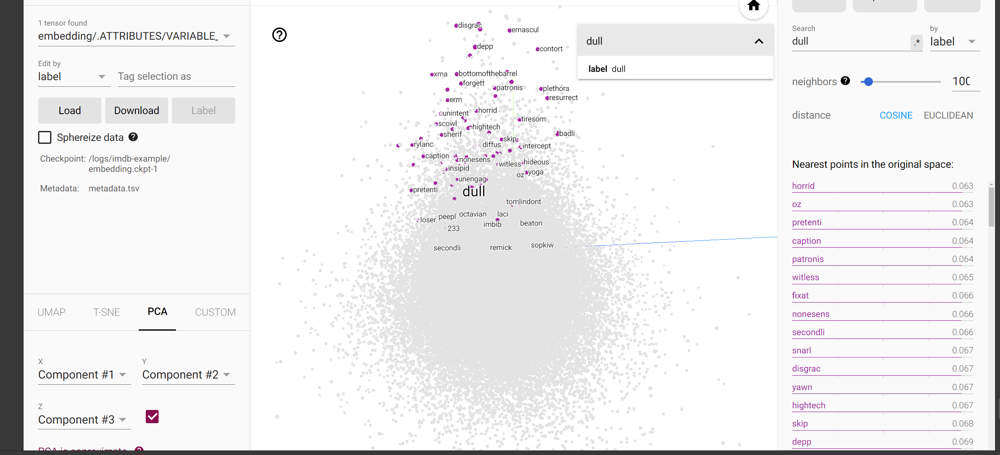

If we take the word 'dull' for example, we can see that 'horrid', 'pretentious', and 'yawn' are close to it which makes a lot of sense.

### Vizualization

Finally, let's see what a positive review looks like using a word cloud:

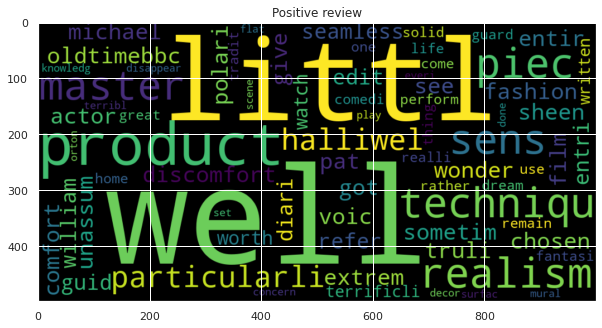

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

plt.figure(figsize=(10, 10))
plt.title('Positive review')
positive_text = x_train[1]
WC = WordCloud(width=1000, height=500, max_words=500, min_font_size=5)
positive_words = WC.generate(positive_text)
plt.imshow(positive_words, interpolation='bilinear')
plt.show()

And a negative one:

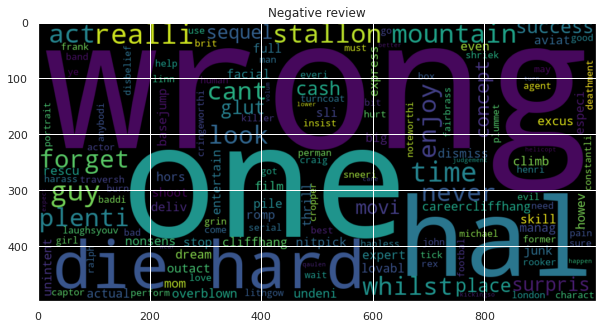

In [ ]:
plt.figure(figsize=(10, 10))
plt.title('Negative review')
positive_text = x_train[20]
WC = WordCloud(width=1000, height=500, max_words=500, min_font_size=5)
words = WC.generate(positive_text)
plt.imshow(words, interpolation='bilinear')
plt.show()